# Configuring a road network from OSM

Import required packages and relavant RA2CE class

In [4]:
import ast
import folium
import random
import sys
import webbrowser
import geopandas as gpd
from IPython.display import display
from matplotlib.pyplot import get_cmap
from matplotlib.colors import to_hex
from pathlib import Path
from supplementary_finctions import visualise_map

sys.path.append(r'C:\repos\ra2ce') # path to the package
from ra2ce.ra2ce_handler import Ra2ceHandler

_network_ini_name = "network.ini"
_analysis_ini_name = "analysis.ini"

> OSM files are usually neater because they are checked before uploading. When using this type of file, segmentations happen automatically.

> An easy way to use this option is by drawing a polygon at the location of choice at [geojson.io](http://geojson.io/). It is also possible to save the polygon as GeoJSON and save it in GeoJSON format in the static/network folder with any name. Specify the file's name in the 'polygon' parameter in the network.ini file (see Section 7.1 of the documentation).
 

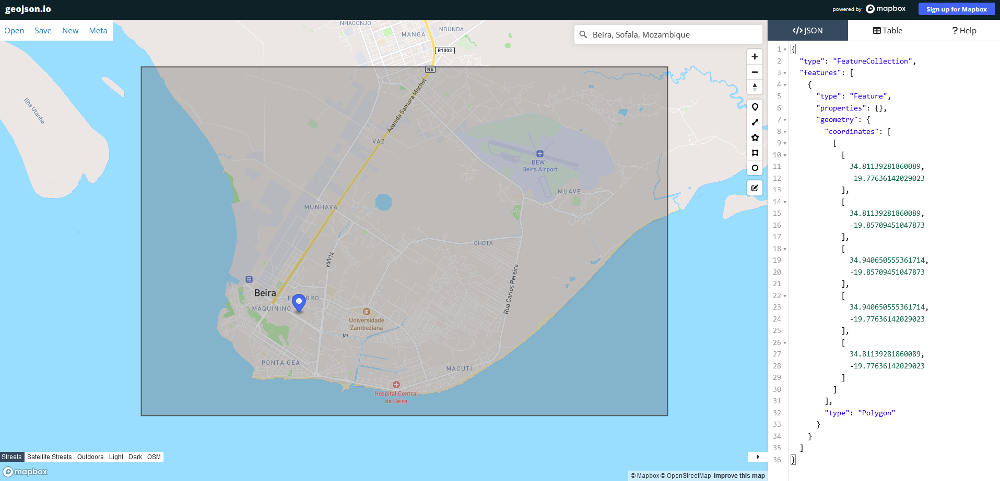

> Thereafter, we need to introduce a network.ini file for network configuration. Section 7.1. of the manual explains the parameters. To configure the network, the [network] section is of relevance. Here we use a polygon to specify the corresponding road network to a region of interest.

> [project]<br>
name = beira<br>
<br>
[network]<br>
directed = False<br>
source = OSM download<br>
primary_file = None<br>
diversion_file = None<br>
file_id = rfid_c<br>
polygon = Extent_Network_wgs84.geojson<br>
network_type = drive<br>
road_types = motorway,motorway_link,primary,primary_link,secondary,secondary_link,tertiary,tertiary_link,residential<br>
save_shp = True<br>
<br>
*[origins_destinations]<br>
origins = None<br>
destinations = None<br>
origins_names = A<br>
destinations_names = B<br>
id_name_origin_destination = OBJECTID<br>
origin_count = PEOPLE<br>              
origin_out_fraction = 1<br>
<br>
[hazard]<br>
hazard_map = None<br>
hazard_id = None<br>
hazard_field_name = waterdepth<br>
aggregate_wl = max<br>
hazard_crs = None $EPSG:4326 <br>
<br>
[cleanup]<br>
snapping_threshold = None <br>
segmentation_length = None <br>
merge_lines = True <br>
merge_on_id = False <br>
cut_at_intersections = False <br>*

> Then we introduce the path to the network.ini, the network initialisation file of the case of interest. We introduced a polygon of a region in Beira in Mozambique to network.ini. 

In [6]:
root_dir = Path(r'C:\repos\ra2ce\examples\beira_graph_configuration')

network_ini = root_dir / _network_ini_name
assert network_ini.is_file()

> Configure (create) the network. We input no analysis.ini for now, including the sets of interest analysis.

In [9]:
handler = Ra2ceHandler(network=network_ini, analysis=None)
handler.configure()

2023-06-02 09:08:10 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-06-02 09:08:10 AM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\beira_graph_configuration\static\output_graph\base_graph.p.
2023-06-02 09:08:10 AM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\beira_graph_configuration\static\output_graph\base_network.feather.
2023-06-02 09:08:10 AM - [networks.py:615] - root - INFO - Apparently, you already did create a network with ra2ce earlier. Ra2ce will use this: C:\repos\ra2ce\examples\beira_graph_configuration\static\output_graph\base_graph.p


> Now, let's visualise the created graphs. First, let's create a function for map visualisation:

In [210]:
def visualise_map(file_names: list, file_paths: list, layer_colors=None):
    # global root_dir
    counter = 0
    layers = []
    if layer_colors is None:
        layer_colors = ['black']
    for file_name, file_path, layer_color in zip(file_names, file_paths, layer_colors):
        full_file_path = Path(str(file_path) + rf'\{file_name}.gpkg')
        gdf = gpd.read_file(full_file_path)
        if counter == 0:
            my_map = gdf.explore(color=layer_color, tiles="CartoDB positron")
            layers.append(my_map)
        else:
            my_map = gdf.explore(m=layers[counter - 1], color=layer_color)
            layers.append(my_map)
        counter = + 1
    display(my_map)

In [211]:
map_file_path = root_dir / r'static\output_graph'
map_file_name_edges = 'base_graph_edges'
map_file_name_nodes = 'base_graph_nodes'
saved_map_file_path = root_dir / r'output'

visualise_map(file_names=[map_file_name_edges, map_file_name_nodes], file_paths=[map_file_path, map_file_path],
              layer_colors=['black', 'green'])

> Let's explore different road types included in the network configuration:

In [156]:
roads_path = root_dir / r'static\output_graph\base_graph_edges.gpkg'

roads_gdf = gpd.read_file(roads_path)

roads_gdf.explore(column='highway', tiles="CartoDB positron")

# Single redundancy test

> This analysis removes each link of the network one at a time. For each disrupted link, a redundancy analysis is performed. It identifies the best existing alternative route or, if there is no redundancy, the lack of alternative routes. This is performed sequentially for each link of the network.

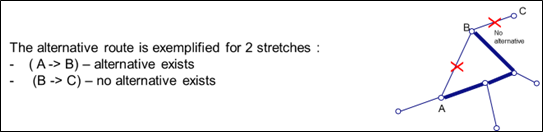

> We perform this analysis for the configured graph in Beira. First, we initialise analysis.ini. The relevant function for this type of analysis is single_link_redundancy. The redundancy of each link is expressed in the total distance (weighing) for the alternative route. Please look at section 7.2. of the manual for more information about the included parameters. Here is the used analysis.ini file:

> [project] <br>
name = beira <br>
 <br>
[analysis1] <br>
name = beira_redundancy <br>
analysis = single_link_redundancy <br>
weighing = distance <br>
save_shp = True <br>
save_csv = True <br>

In [160]:
root_dir = Path(r'C:\repos\ra2ce\examples\beira_graph_configuration')
root_dir = Path(r'C:\repos\ra2ce\examples\beira__single_link_redundancy')

analysis_ini = root_dir / _analysis_ini_name
assert analysis_ini.is_file()

> We configure and run the test by the following methods from the Ra2ceHandler class. No network is introduced to the Ra2ceHandler object to use the existing configure graph created in the previous feature example.

In [46]:
handler = Ra2ceHandler(network=network_ini, analysis=analysis_ini)
handler.configure()
handler.run_analysis()

2023-05-26 09:51:25 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 09:51:25 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 09:51:25 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 09:51:25 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 09:51:25 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 09:51:25 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 09:51:25 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 09:51:25 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 09:51:25 AM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\beira_graph_configuration\static\output_graph\base_graph.p.
2023-05-26 09:51:25 AM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce

2023-05-26 09:51:27 AM - [analyses_indirect.py:1335] - root - INFO - ----------------------------- Analysis 'arusha_redundancy' finished. Time: 1.91s  -----------------------------
2023-05-26 09:51:27 AM - [analyses_indirect.py:1335] - root - INFO - ----------------------------- Analysis 'arusha_redundancy' finished. Time: 1.91s  -----------------------------
2023-05-26 09:51:27 AM - [analyses_indirect.py:1335] - root - INFO - ----------------------------- Analysis 'arusha_redundancy' finished. Time: 1.91s  -----------------------------
2023-05-26 09:51:27 AM - [analyses_indirect.py:1335] - root - INFO - ----------------------------- Analysis 'arusha_redundancy' finished. Time: 1.91s  -----------------------------
2023-05-26 09:51:27 AM - [analyses_indirect.py:1335] - root - INFO - ----------------------------- Analysis 'arusha_redundancy' finished. Time: 1.91s  -----------------------------
2023-05-26 09:51:27 AM - [analyses_indirect.py:1335] - root - INFO - --------------------------

> After running the redundancy check, we look at the map representing the roads with and without redundancy. In the second map, we can explore the normal distance between nodes of the graph links (i.e. link's length). In contrast, the last map demonstrates the length of the alternative routes between the nodes of each graph's link when assuming the unavailability of that single link (i.e. attribute alt_dist referring to the alternative distance). 

In [199]:
redundancy_gdf = gpd.read_file(root_dir / r'output\single_link_redundancy\beira_redundancy.gpkg')
redundancy_gdf['redundancy'] = redundancy_gdf ['detour'].astype(str)
alt_dist_gpd = redundancy_gdf[redundancy_gdf['detour']==1]

redundant_roads_map = redundancy_gdf.explore(column='redundancy', tiles="CartoDB positron", cmap=['red', 'green'])
display(redundant_roads_map)

noraml_dist_map = roads_normal_dist_gdf.explore(column='length', tiles="CartoDB positron", cmap='cividis')
display(noraml_dist_map)

alt_dist_map = alt_dist_gpd.explore(column='alt_dist', tiles="CartoDB positron", cmap='cividis')
display(alt_dist_map)

> It should be noted that there might be cases where the alternative distances can be of any relationship in terms of magnitude compared with the normal distances (lengths of links before exclusion). In the example below, the alternative distance between nodes 818 and 828 is longer than the normal length of road 1622. 

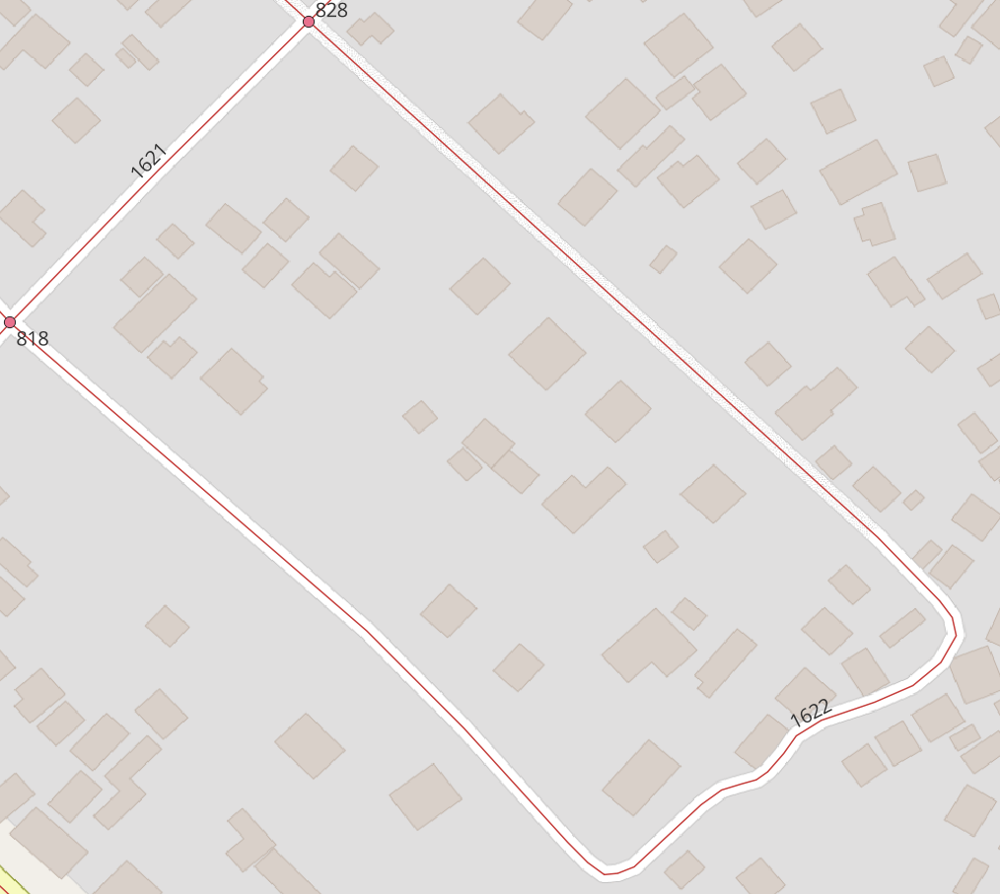

# Origin-Destination, defined origins to closest destinations

> This analysis finds **the shortest (distance-weighed) or quickest (time-weighed) route** from all Origins to the closest Destinations input by the user. 

> Let's find the optimal routes for the configured Beira network with no hazard disruption. 

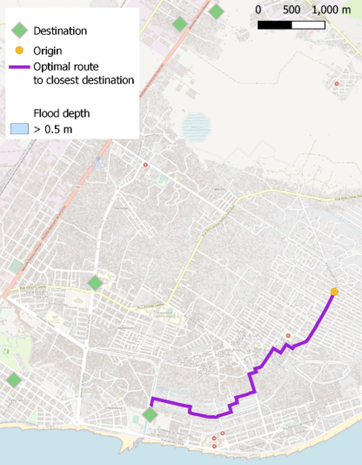

> We need new network and analysis initialisation files, which include Origin-Destination (OD) matrix and **optimal_route_origin_closest_destination** analysis, respectively.

**Network.ini content**
<br>
<br>
> [project]<br>
name = beira<br>
<br>
[network]<br>
directed = False<br>
source = OSM download<br>
primary_file = None<br>
diversion_file = None<br>
file_id = rfid_c<br>
polygon = Extent_Network_wgs84.geojson<br>
network_type = drive<br>
road_types = motorway,motorway_link,primary,primary_link,secondary,secondary_link,tertiary,tertiary_link,residential<br>
save_shp = True<br>
<br>
[origins_destinations]<br>
origins = origins_worldpop_wgs84.shp<br>
destinations = destinations_all_good_wgs84.shp<br>
origins_names = A<br>
destinations_names = B<br>
id_name_origin_destination = OBJECTID<br>
origin_count = POPULATION<br>                         
origin_out_fraction = 1<br>
category = category<br>
<br>
*[hazard]<br>
hazard_map = None<br>
hazard_id = None<br>
hazard_field_name = waterdepth<br>
aggregate_wl = max<br>
hazard_crs = None<br>
<br>
[cleanup]<br>
snapping_threshold = None<br>
segmentation_length = None<br>
merge_lines = True<br>
merge_on_id = False<br>
cut_at_intersections = False<br>*


**Analysis.ini content**
<br>
<br>
> [project] <br>
name = beira <br>
<br>
[analysis1] <br>
name = optimal_route_od <br>
analysis = optimal_route_origin_destination <br>
weighing = distance <br>
save_shp = True <br>
save_csv = True <br>

In [7]:
root_dir = Path(r'C:\repos\ra2ce\examples\beira_optimal_route_od')

network_ini = root_dir / _network_ini_name
assert network_ini.is_file()

analysis_ini = root_dir / _analysis_ini_name
assert analysis_ini.is_file()

Initialise and run the test.

In [52]:
handler = Ra2ceHandler(network=network_ini, analysis=analysis_ini)
handler.configure()
handler.run_analysis()

2023-05-26 10:09:04 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 10:09:04 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 10:09:04 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 10:09:04 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 10:09:04 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 10:09:04 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 10:09:04 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 10:09:04 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 10:09:04 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 10:09:04 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-26 10:09:04 AM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\

2023-05-26 10:09:05 AM - [networks.py:615] - root - INFO - Apparently, you already did create a network with ra2ce earlier. Ra2ce will use this: C:\repos\ra2ce\examples\beira_optimal_route_od\static\output_graph\base_graph.p
2023-05-26 10:09:05 AM - [networks.py:615] - root - INFO - Apparently, you already did create a network with ra2ce earlier. Ra2ce will use this: C:\repos\ra2ce\examples\beira_optimal_route_od\static\output_graph\base_graph.p
2023-05-26 10:09:05 AM - [analyses_indirect.py:1058] - root - INFO - ----------------------------- Started analyzing 'optimal_route_od'  -----------------------------
2023-05-26 10:09:05 AM - [analyses_indirect.py:1058] - root - INFO - ----------------------------- Started analyzing 'optimal_route_od'  -----------------------------
2023-05-26 10:09:05 AM - [analyses_indirect.py:1058] - root - INFO - ----------------------------- Started analyzing 'optimal_route_od'  -----------------------------
2023-05-26 10:09:05 AM - [analyses_indirect.py:10

> Finally, we visualise the map. We can find the optimal routes between ODs by hovering on the links and investigating the *opt_path* attribute. The optimal_route_od.gpkg is the result of this analysis that contains all optimal routes between all OD pairs.<br>
<br>
> Bellow, we visualise the filtered results for the optimal routes (blue links) from one origin (red node) to all destinations (green nodes). The grey road network shows all the included links. Please note that the origins_filtered and destinations layers introduced below are the modified versions of the origin_destination_table. gpkg data generated in the network configuration step. 

In [26]:
output_file_path = root_dir / r'output\optimal_route_origin_destination'

base_edges_gdf = gpd.read_file(root_dir / r'static\output_graph\base_graph_edges.gpkg')
base_edges_gdf['grey_links_legend'] = 'All links'
base_edges_map = base_edges_gdf.explore(column='grey_links_legend', tiles="CartoDB positron", cmap=['grey'])

optimal_route_od_filtered_gdf = gpd.read_file(output_file_path / r'optimal_route_od_filtered.gpkg')
optimal_route_od_filtered_gdf['blue_links_legend'] = 'Optimal routes'
optimal_route_od_filtered_map = optimal_route_od_filtered_gdf.explore(m=base_edges_map, column='blue_links_legend', 
                                                                      tiles="CartoDB positron", cmap=['blue'])

origins_filtered_gdf = gpd.read_file(output_file_path / r'origins_filtered.gpkg')
origins_filtered_gdf['red_node_legend'] = 'Origin A_257'
origins_filtered_map = origins_filtered_gdf.explore(m=optimal_route_od_filtered_map, column='red_node_legend',
                                                    tiles="CartoDB positron", cmap=['red'], marker_kwds={'radius':7})

destinations_gdf = gpd.read_file(output_file_path / r'destinations.gpkg')
destinations_gdf['green_nodes_legend'] = 'Destinations'
origins_filtered_map = destinations_gdf.explore(m=origins_filtered_map, column='green_nodes_legend',
                                                tiles="CartoDB positron", cmap=['green'], marker_kwds={'radius':7})

display(origins_filtered_map)


> Now assume a flood event. We perform the **multi_link_origin_closest_destination** analysis to determine what the closest non-disrupted accessible destination is for each origin given the hazard, compared to the situation without a hazard, including the route.

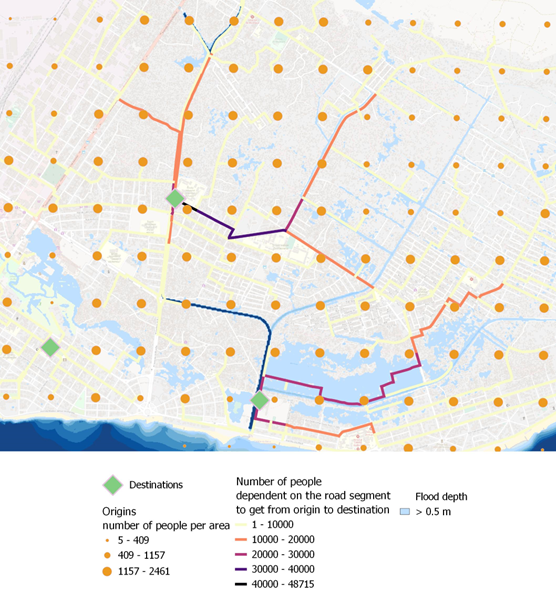

> Let's perform such an analysis. Initialising the .ini files happen in the same way as in the previous examples. For this example, we need a flood map (max_flood_depth.tif in network.ini) and a maximum water depth threshold (threshold in analysis.ini in meters) from which road segments become dysfunctional. Moreover, the aggregate_wl parameter in analysis.ini can be set to either 'max', 'min' or 'mean' to take the maximum, minimum or mean water depth per road segment when the exposure of the roads to a certain hazard (map) is determined.<br>
<br>
Bellow the configured base graph edges, origins (light yellow nodes), destinations, and flood map are presented. Demand nodes are derived from a raster file representing the region's population. That is the reason behind their grid-like placements.

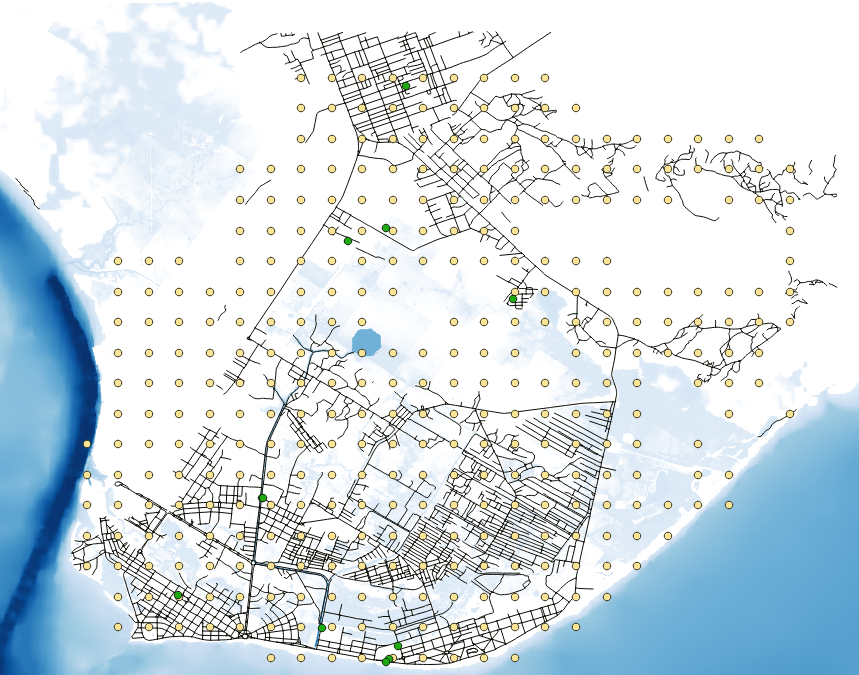

**Network.ini content**
<br>
<br>
> [project]<br>
name = beira<br>
<br>
[network]<br>
directed = False<br>
source = OSM download<br>
primary_file = None<br>
diversion_file = None<br>
file_id = rfid_c<br>
polygon = Extent_Network_wgs84.geojson<br>
network_type = drive<br>
road_types = motorway,motorway_link,primary,primary_link,secondary,secondary_link,tertiary,tertiary_link,residential<br>
save_shp = True<br>
<br>
[origins_destinations]<br>
origins = origins_worldpop_wgs84.shp<br>
destinations = destinations_all_good_wgs84.shp<br>
origins_names = A<br>
destinations_names = B<br>
id_name_origin_destination = OBJECTID<br>
origin_count = POPULATION<br>                         
origin_out_fraction = 1<br>
category = category<br>
<br>
[hazard]<br>
hazard_map = max_flood_depth.tif<br>
hazard_id = None<br>
hazard_field_name = waterdepth<br>
aggregate_wl = max<br>
hazard_crs = EPSG:32736<br>
<br>
*[cleanup]<br>
snapping_threshold = None<br>
segmentation_length = None<br>
merge_lines = True<br>
merge_on_id = False<br>
cut_at_intersections = False<br>*


**analysis.ini content**
<br>
<br>
> [project]<br>
name = beira<br>
<br>
[analysis1]<br>
name = multilink origin closest dest<br>
analysis = multi_link_origin_closest_destination<br>
aggregate_wl = max<br>
threshold = 0.5<br>
weighing = distance<br>
calculate_route_without_disruption = True<br>
save_shp = True<br>
save_csv = True<br>

In [53]:
root_dir = Path(r'C:\repos\ra2ce\examples\beira_multi_o_closest_d')

network_ini = root_dir / _network_ini_name
assert network_ini.is_file()

analysis_ini = root_dir / _analysis_ini_name
assert analysis_ini.is_file()

> Configure and run:

In [17]:
handler = Ra2ceHandler(network=network_ini, analysis=analysis_ini)
handler.configure()
handler.run_analysis()

2023-05-30 04:51:11 PM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-30 04:51:11 PM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-30 04:51:11 PM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-05-30 04:51:11 PM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\static\output_graph\base_graph.p.
2023-05-30 04:51:11 PM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\static\output_graph\base_graph.p.
2023-05-30 04:51:11 PM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\static\output_graph\base_graph.p.
2023-05-30 04:51:11 PM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\static\output_graph\base_network.feathe

2023-05-30 04:51:26 PM - [multi_graph_network_exporter.py:45] - root - INFO - Saved origins_destinations_graph_hazard_edges.shp and origins_destinations_graph_hazard_nodes.shp in C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\static\output_graph.
2023-05-30 04:51:26 PM - [hazard.py:875] - root - INFO - Saved origin_destination_table.feather in C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\static\output_graph.
2023-05-30 04:51:26 PM - [hazard.py:875] - root - INFO - Saved origin_destination_table.feather in C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\static\output_graph.
2023-05-30 04:51:26 PM - [hazard.py:875] - root - INFO - Saved origin_destination_table.feather in C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\static\output_graph.
2023-05-30 04:51:26 PM - [hazard.py:887] - root - INFO - Saved origin_destination_table in C:\repos\ra2ce\examples\st_maarten_multi_O_closest_D\static\output_graph.
2023-05-30 04:51:26 PM - [hazard.py:887] - root - INFO - Saved 

2023-05-30 04:53:14 PM - [analyses_indirect.py:1358] - root - INFO - Results saved to: C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\output\multi_link_origin_closest_destination\multilink_origin_closest_dest_optimal_routes_without_hazard.gpkg
2023-05-30 04:53:14 PM - [analyses_indirect.py:1358] - root - INFO - Results saved to: C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\output\multi_link_origin_closest_destination\multilink_origin_closest_dest_optimal_routes_without_hazard.gpkg
2023-05-30 04:53:14 PM - [analyses_indirect.py:1358] - root - INFO - Results saved to: C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\output\multi_link_origin_closest_destination\multilink_origin_closest_dest_optimal_routes_without_hazard.gpkg
2023-05-30 04:53:14 PM - [analyses_indirect.py:1358] - root - INFO - Results saved to: C:\repos\ra2ce\examples\st_maarten_multi_o_closest_d\output\multi_link_origin_closest_destination\multilink_origin_closest_dest_optimal_routes_with_hazard.gpkg
202

> Now we can explore which origins have access to the destinations (in multilink_origin_closest_dest_origins.gpkg), or available optimal routes from all origins to all destinations, with the number of people using the links under the impact of the introduced hazard (in multilink_origin_closest_dest_optimal_routes_with_hazard.gpkg).

> We visualise the access/no-access states of the origins of educational institutes:

In [54]:
analysis_output_path = root_dir / r'output\multi_link_origin_closest_destination'
gdf = gpd.read_file(analysis_output_path / 'multilink_origin_closest_dest_origins.gpkg')
gdf.explore(column='education', cmap=['green', 'red'])

> Here, the optimal routes of the A_1 origin to the closest destinations (educational institute and hospital) are visualised.

> Moreover, all optimal routes to B_5 hospital (blue node) destination are demonstrated.

In [55]:
analysis_output_path = root_dir / r'output\multi_link_origin_closest_destination'
origin_gdf = gpd.read_file(analysis_output_path / 'multilink_origin_closest_dest_origins.gpkg')
destinations_gdf = gpd.read_file(analysis_output_path / 'multilink_origin_closest_dest_destinations.gpkg')
optimal_routes_gdf = gpd.read_file(analysis_output_path / 'multilink_origin_closest_dest_optimal_routes_with_hazard.gpkg')

b_5_gdf = destinations_gdf[destinations_gdf['d_id']=='B_5']
optimal_routes_b_5_gdf = optimal_routes_gdf[optimal_routes_gdf['destination'] == 'B_5']
origins_with_optimal_route_b_5 = origin_gdf[origin_gdf['o_id'].isin(optimal_routes_b_5_gdf['origin'])]

optimal_routes_b_5_map = optimal_routes_b_5_gdf.explore(color='black')
b_5_map = b_5_gdf.explore(m=optimal_routes_b_5_map, color='blue', marker_kwds={'radius':5})
origins_with_optimal_route_b_5.explore(m=b_5_map, color='green', marker_kwds={'radius':5})


# Elaborate example: emergency response

> This example aims to support delivering emergency responses to a flood event in Beira. Emergency responders are interested in gaining insights into the locations of the residential areas impacted by the event, accessible routes to locations that will function as shelters during a part of the recovery phase, and isolated residential areas.<br>
<br>
In this example, educational institutes and hospitals are considered destinations after the flood (as shelters).

> We first identify the required analysis sets. The required insights can be answered by accessibility analysis.<br>
<br>
> 1. To analyse finds the sections of the network that are fully isolated from the rest of the network (also named disconnected islands) due to the hazard-induced disruption, we run the multi_link_isolated_locations analysis. A location is considered ‘isolated’ when part of a fully isolated network (a disconnected island) but not directly affected by the hazard.<br>
<br>
> 2. To determine what the closest non-disrupted accessible destination is for each origin given the hazard, we use multi_link_origin_closest_destination in analyses.ini. This analysis outputs the residential areas which have access to the shelter destinations.
<br>

> Bellow, the networ.ini and analysis.ini are presented respectively:

> [project]<br>
name = beira_emergency_response<br>
<br>
[network]<br>
directed = False<br>
source = OSM download<br>
primary_file = None<br>
diversion_file = None<br>
file_id = rfid_c<br>
polygon = Extent_Network_wgs84.geojson<br>
network_type = drive<br>
road_types = motorway,motorway_link,trunk,trunk_link,primary,primary_link,secondary,secondary_link,tertiary,tertiary_link,unclassified,residential<br>
save_shp = True<br>
<br>
[origins_destinations]<br>
origins = origins_worldpop_wgs84.shp<br>
destinations = destinations_all_good_wgs84.shp<br>
origins_names = A<br>
destinations_names = B<br>
id_name_origin_destination = OBJECTID<br>
origin_count = POPULATION           <br>              
origin_out_fraction = 1<br>
category = category<br>
<br>
[hazard]<br>
hazard_map = max_flood_depth.tif<br>
hazard_id = None<br>
hazard_field_name = waterdepth<br>
aggregate_wl = max<br>
hazard_crs = EPSG:32736<br>
<br>
[isolation]<br>
locations = origins_worldpop_wgs84.shp *# This is needed to investigate the isolated areas* <br>
<br>
*[cleanup]<br>
snapping_threshold = None<br>
pruning_threshold = None<br>
segmentation_length = None<br>
merge_lines = None<br>
ignore_intersections = None<br>*


> [project]<br>
name = beira_emergency_response<br>
<br>
[analysis1]<br>
name = multi-link origin dest test<br>
analysis = multi_link_origin_destination<br>
aggregate_wl = max<br>
threshold = 0.5<br>
weighing = distance<br>
save_shp = True<br>
save_csv = True<br>
<br>
[analysis2]<br>
name = multi-link origin closest destination<br>
analysis = multi_link_origin_closest_destination<br>
aggregate_wl = max<br>
threshold = 0.5<br>
weighing = distance<br>
calculate_route_without_disruption = True<br>
save_shp = True<br>
save_csv = True<br>
<br>
[analysis3]<br>
name = multi-link isolated locations<br>
analysis = multi_link_isolated_locations<br>
aggregate_wl = max<br>
threshold = 0.5<br>
weighing = length<br>
buffer_meters = 500<br>
category_field_name = category<br>
save_shp = True<br>
save_csv = True<br>

> We introduce, configure and run the analysis sets:

In [5]:
root_dir = Path(r'C:\repos\ra2ce\examples\beira_emergency_response')

network_ini = root_dir / _network_ini_name
assert network_ini.is_file()

analysis_ini = root_dir / _analysis_ini_name
assert analysis_ini.is_file()

In [72]:
handler = Ra2ceHandler(network=network_ini, analysis=analysis_ini)
handler.configure()
handler.run_analysis()

2023-06-05 09:19:23 AM - [ra2ce_logging.py:41] - root - INFO - RA2CE logger initialized.
2023-06-05 09:19:23 AM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\beira_emergency_response\static\output_graph\base_graph.p.
2023-06-05 09:19:23 AM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\beira_emergency_response\static\output_graph\base_network.feather.
2023-06-05 09:19:23 AM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\beira_emergency_response\static\output_graph\origins_destinations_graph.p.
2023-06-05 09:19:23 AM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\beira_emergency_response\static\output_graph\base_graph_hazard.p.
2023-06-05 09:19:23 AM - [network_config.py:118] - root - INFO - Existing graph/network found: C:\repos\ra2ce\examples\beira_emergency_response\static\output_graph\orig

> **multi_link_isolated_locations results:**

 > 1. *residential areas flooded (> 0.5 m) with waterdepth information and corresponding population in each node's attributes:* Red nodes represent the inundated residential regions.

In [99]:
analysis_output_path = root_dir / r'output\multi_link_isolated_locations'

affected_origins_gdf = gpd.read_file(analysis_output_path / 'multilink_isolated_locations.gpkg')
affected_origins_gdf['inundated'] = affected_origins_gdf['EV1_ma'].apply(lambda x: '1' if x > 0.5 else '0')

affected_origins_gdf.explore(column='inundated', cmap=['green', 'red'], tiles="CartoDB positron")

> 2. *Isolated residential areas:* <br>
<br> This analysis finds the sections of the network that are fully isolated from the rest of the network (also named disconnected islands), because of network disruption due to a hazard. These locations are not necessarily inundated, but are isolated as disconnected from the larger network due to flooding elsewhere. 

<br>

**Issue with the following map** as if we are passing float, it neads a color spectrum!

In [94]:
affected_origins_gdf.explore(column='i_EV1', legend=False, tiles="CartoDB positron")

affected_origins_gdf['isolated'] = affected_origins_gdf['i_EV1'].apply(lambda x: '1' if x == 1 else '0')

affected_origins_gdf.explore(column='isolated', cmap=['green', 'red'], tiles="CartoDB positron")

> We overlay the accessible/not-accessible and isolated/connected analysis layers on top of each other. Filled circles show whether the areas are inundated (red and green, respectively). Circles without area colours show whether the areas are isolated (red and green, respectively). By this means, we can trace both inundated and isolated areas.

> Thereafter, we overlay the available roads (green-coloured links), meaning that the maximum water depth is 0.5 meters or lower (threshold in the network.ini).

> Additionally, we overlay the roads that are inundated with a maximum water level of above 0.5 meters on the available road network (green-coloured links).

In [96]:
inundated_map = affected_origins_gdf.explore(column='inundated', cmap=['darkgreen', 'darkred'], marker_type="circle_marker"
                                             , marker_kwds={'radius':2}, legend=False, tiles="CartoDB positron")
isolated_inundated_map = affected_origins_gdf.explore(m=inundated_map, column='isolated', cmap=['darkgreen', 'darkred'],
                             marker_type="circle", marker_kwds={'radius':150}, legend=False)
display(isolated_inundated_map)

inundated_map = affected_origins_gdf.explore(column='inundated', cmap=['darkgreen', 'darkred'], marker_type="circle_marker"
                                             , marker_kwds={'radius':2}, legend=False)
roads_gdf = gpd.read_file(root_dir / r'static\output_graph\base_graph_hazard_edges.gpkg')
impacted_roads_gdf = roads_gdf[roads_gdf['EV1_ma'] > 0.5]

open_roads_gdf = roads_gdf[roads_gdf['EV1_ma'] <= 0.5]
open_roads_map = open_roads_gdf.explore(m=isolated_inundated_map, color='green')
display(open_roads_map)

impacted_roads_map = impacted_roads_gdf.explore(tiles='CartoDB dark_matter',m=isolated_inundated_map, column='EV1_ma',
                                                cmap='cool', legend_kwds={'caption':'water depth (m)'})
display(impacted_roads_map)

> **multi_link_origin_closest_destination results:**

1. *the access of the residential areas to each type of destination:* We show the residential areas without access to the destinations.

In [85]:
analysis_output_path = root_dir / r'output\multi_link_origin_closest_destination'

origins_gdf = gpd.read_file(analysis_output_path / 'multilink_origin_closest_dest_origins.gpkg')
no_access_gdf = origins_gdf[origins_gdf['EV1_ma_AD1']=='no access']

no_access_gdf.explore(column='POPULATION', cmap='cool', marker_kwds={'radius':5}, tiles="CartoDB positron")

> 2. *the expected usage levels of the destination nodes:* We present the demand for the accessible destinations (hospitals and educational institutions).

In [84]:
analysis_output_path = root_dir / r'output\multi_link_origin_closest_destination'

destinations_gdf = gpd.read_file(analysis_output_path / 'multilink_origin_closest_dest_destinations.gpkg')
destinations_gdf['demand'] = destinations_gdf['EV1_ma_PD1'] + destinations_gdf['EV1_ma_PD2'].fillna(0)
accessible_destinations_gdf = destinations_gdf[destinations_gdf['demand'] > 0]

accessible_destinations_gdf.explore(column='demand', cmap='cool', marker_kwds={'radius':5}, tiles="CartoDB positron")

> 3. Bellow, we visualise all optimal routes to accessible destinations.

In [159]:
analysis_output_path = root_dir / r'output\multi_link_origin_closest_destination'

optimal_routes_hazard_gdf = \
        gpd.read_file(analysis_output_path / 'multilink_origin_closest_dest_optimal_routes_with_hazard.gpkg')
destinations_gdf = gpd.read_file(analysis_output_path / 'multilink_origin_closest_dest_destinations.gpkg')

cmap = get_cmap()
colors = cmap.colors

for i, accessible_destination in enumerate(set(optimal_routes_hazard_gdf['destination'].to_numpy())):
    optimal_routes_destination_gdf = \
        optimal_routes_hazard_gdf[optimal_routes_hazard_gdf['destination'] == accessible_destination]
    color = random.choice(colors)
    layer_color = to_hex(color)
    if i == 0:
        combined_node_link_map = optimal_routes_destination_gdf.explore(color=layer_color, tiles="CartoDB positron")
    else:
        combined_node_link_map = optimal_routes_destination_gdf.explore(m=combined_node_link_map,
                                                                        color=layer_color)
    destination_gdf = destinations_gdf[destinations_gdf['d_id'] == accessible_destination]
    combined_node_link_map = destination_gdf.explore(m=combined_node_link_map, color=layer_color,
                                                     marker_kwds={'radius': 5})
    
display(combined_node_link_map)

# Long-term adaptation planning elaborate example

> Project folder name: Zuidholland_direct_indirect <br>
Aim: Understanding the effects of a flooding event on the road infrastructures <br>
Scenario 1: Run the following on the existing road network <br>
&nbsp;&nbsp;&nbsp;&nbsp;1) Multi-link redundancy analysis (indirect damage analysis) <br>
&nbsp;&nbsp;&nbsp;&nbsp;2) Huizinga direct damage analysis (single or multi-hazard) <br>
<br>
Scenario 2: Edit the road network by adding or changing links (e.g., upgrading links' attribute) or make use of the cut_from_mode functionality (section 6.2.7 of the RA2CE documentation) in the case of a multi-hazard run. Another option can be increasing the water depth threshold (m) relevant to the multi-link redundancy analysis. <br>
&nbsp;&nbsp;&nbsp;&nbsp;Perform the above-mentioned checks.

In [ ]:
# Code ran in the PyCharm Zuidholland_direct_indirect.py file
from pathlib import Path

import geopandas as gpdb
import pytest

from ra2ce.analyses.direct.damage_calculation.damage_network_events import (
    DamageNetworkEvents,
)
from ra2ce.configuration.config_factory import ConfigFactory
from ra2ce.configuration.network.network_config import hazard_handler, NetworkConfig

from ra2ce.graph.networks import Network
from ra2ce.ra2ce_handler import Ra2ceHandler

project_name = Path(__file__).resolve().stem
root_dir = Path(rf'C:\repos\ra2ce\examples\{project_name}')
output_graphs_dir = root_dir / r'static\output_graph'

damage_function = "HZ"
_network_ini_name = "network.ini"

network_ini = root_dir / _network_ini_name
assert network_ini.is_file()

handler = Ra2ceHandler(network=network_ini, analysis=None)
handler.configure()

base_graph_hazard_edges_gdf = gpd.read_file(output_graphs_dir / r'base_graph_hazard_edges.gpkg')

val_cols = [
    col for col in base_graph_hazard_edges_gdf.columns if (col.split("_")[0].isupper())
]

event_gdf = DamageNetworkEvents(base_graph_hazard_edges_gdf, val_cols)
event_gdf.main(damage_function=damage_function)

> **Issue with the direct damage**: <br>
Direct damage calculation, Huizinga function: <br>
&nbsp;&nbsp;&nbsp;&nbsp;a.	network_trails_import in networks.py does not filter on the user-specified road_types. <br>
&nbsp;&nbsp;&nbsp;&nbsp;b.	Direct damage hazard mapping does not publish values for EV_me <br>
&nbsp;&nbsp;&nbsp;&nbsp;(example Zuidholland_direct_indirect, hazard: Delfland_200mm_GHG.tif hazard map) <br>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;i.	It publishes for the max water depth. <br>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;ii.	A fraction of the flooded links are also generated in both the mean and max options. <br>
&nbsp;&nbsp;&nbsp;&nbsp;c.	In damage_network_base.py .lookup() is changed. <br>
<br>
> **Quick fix suggestion**: <br>
&nbsp;&nbsp;&nbsp;&nbsp;Change the coloumn EVi_ma to EVi_me and run the analysis for the demonstration porpuses.